# Inference notenook for [CLIP prefix captioning](https://github.com/rmokady/CLIP_prefix_caption/)

Disclaimer: the authors do not own any rights for the code or data.

In [1]:

!pip install git+https://github.com/openai/CLIP.git


  Cloning https://github.com/openai/CLIP.git to c:\users\marti\appdata\local\temp\pip-req-build-lcgngd6o
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'


  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git 'C:\Users\marti\AppData\Local\Temp\pip-req-build-lcgngd6o'


In [2]:
!pip install transformers

In [1]:
import os
os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"

In [2]:
#@title Imports

import clip
import os
from torch import nn
import numpy as np
import torch
import torch.nn.functional as nnf
import sys
from typing import Tuple, List, Union, Optional
from transformers import GPT2Tokenizer, GPT2LMHeadModel, AdamW, get_linear_schedule_with_warmup
from tqdm import tqdm, trange
#from google.colab import files
import skimage.io as io
import PIL.Image
from IPython.display import Image
#from tqdm import tqdm


N = type(None)
V = np.array
ARRAY = np.ndarray
ARRAYS = Union[Tuple[ARRAY, ...], List[ARRAY]]
VS = Union[Tuple[V, ...], List[V]]
VN = Union[V, N]
VNS = Union[VS, N]
T = torch.Tensor
TS = Union[Tuple[T, ...], List[T]]
TN = Optional[T]
TNS = Union[Tuple[TN, ...], List[TN]]
TSN = Optional[TS]
TA = Union[T, ARRAY]


D = torch.device
CPU = torch.device('cpu')


def get_device(device_id: int) -> D:
    if not torch.cuda.is_available():
        return CPU
    device_id = min(torch.cuda.device_count() - 1, device_id)
    return torch.device(f'cuda:{device_id}')


CUDA = get_device

current_directory = os.getcwd()
save_path = os.path.join(os.path.dirname(current_directory), "pretrained_models")
os.makedirs(save_path, exist_ok=True)
model_path = os.path.join(save_path, 'model_wieghts.pt')


In [5]:
!pip install nltk

                                              0.0/1.5 MB ? eta -:--:--
                                              0.0/1.5 MB 640.0 kB/s eta 0:00:03
     -----                                    0.2/1.5 MB 3.1 MB/s eta 0:00:01
     --------------------                     0.8/1.5 MB 7.0 MB/s eta 0:00:01
     ------------------------                 0.9/1.5 MB 5.9 MB/s eta 0:00:01
     ----------------------------             1.1/1.5 MB 5.2 MB/s eta 0:00:01
     ------------------------------           1.2/1.5 MB 4.3 MB/s eta 0:00:01
     ----------------------------------       1.3/1.5 MB 4.1 MB/s eta 0:00:01
     -------------------------------------    1.4/1.5 MB 3.9 MB/s eta 0:00:01
     ---------------------------------------- 1.5/1.5 MB 3.7 MB/s eta 0:00:00


In [3]:
import csv
reference = []
with open("testing3.csv", newline='') as f:
    csvreader = csv.reader(f)
    for row in csvreader:
        reference.append(row[1])
print(reference)

['a taxi parked on the road in front of a post and a fence on the sidewalk', 'people sitting and using their phone in the subway station', 'the escalators that go down further forward', 'the storefront of a boutique with dresses on display', 'a crowd of people walking up a few steps of staircase', 'a woman holding a sign standing in front of an elevator', 'people on the right of an elevator with transparent door', 'the escalators that go upwards on the left of a white pillar', 'the storefront of a convenience store', 'rows of shoes and socks on display on the shelf next to the white brick wall', 'the crosswalks to the opposite side and to the right side with a man riding a bicycle on it', 'a sign with text on it on wall on the wall and a steel door next to it', 'holding a peer in front of a shlef full of different kinds of fruits', 'A wine bottle and two shelves with more wine bottles', 'Yellow crossing in front with walking light red and car traffic lights that are green', 'subway ent

In [22]:
# Import the required modules
from pycocoevalcap.spice.spice import Spice
from pycocoevalcap.tokenizer.ptbtokenizer import PTBTokenizer

# Initialize the SPICE tokenizer
tokenizer = PTBTokenizer()

# Initialize the SPICE scorer
spice_scorer = Spice()

predicted_captions = [{"image_id": 0, "caption": "A man is playing a guitar."}]
print(predicted_captions.items())
ground_truth_captions = {"image_id": 0, "caption": "A man is playing a guitar and singing."}
#predicted_captions = "A man is playing a guitar."
#ground_truth_captions = "A man is playing a guitar and singing."

# Tokenize the predicted and ground-truth captions
predicted_tokens = tokenizer.tokenize(predicted_captions)
ground_truth_tokens = tokenizer.tokenize(ground_truth_captions)

# Compute the SPICE score
spice_score, _ = spice_scorer.compute_score(ground_truth_tokens, predicted_tokens)

# Print the SPICE score
print("SPICE score: {:.4f}".format(spice_score))


AttributeError: 'list' object has no attribute 'items'

In [1]:
from pycocotools.coco import COCO
from pycocoevalcap.eval import COCOEvalCap

annotation_file = 'annotation.json'
results_file = 'results.json'

annotation = {"image_id": 0, "caption": "Hello World"}
result = {"image_id": 0, "caption": "Hello World"}
with open(annotation_file, 'w') as f:
    json.dump(annotation, f)
with open(results_file, 'w') as f:
    json.dump(result, f)

# create coco object and coco_result object
coco = coco.loadRes(annotation_file)
coco_result = coco.loadRes(results_file)

# create coco_eval object by taking coco and coco_result
coco_eval = COCOEvalCap(coco, coco_result)

# evaluate on a subset of images by setting
# coco_eval.params['image_id'] = coco_result.getImgIds()
# please remove this line when evaluating the full validation set
coco_eval.params['image_id'] = coco_result.getImgIds()

# evaluate results
# SPICE will take a few minutes the first time, but speeds up due to caching
coco_eval.evaluate()

# print output evaluation scores
for metric, score in coco_eval.eval.items():
    print(f'{metric}: {score:.3f}')

NameError: name 'json' is not defined

In [7]:
import json
from pycocotools.coco import COCO
from pycocoevalcap.eval import COCOEvalCap

annotation_file = 'annotation.json'
results_file = 'results.json'

# Define the image file path and caption
image_file = 'annotation.jpg'
caption = 'A cat sitting on a windowsill.'

# Create a dictionary with information about the image
image_info = {
    'id': 0,
    'file_name': image_file,
    'width': 640,
    'height': 480
}

# Create a list with information about the annotation (only one image, so the image_id is always 0)
annotation_info = [
    {
        'id': 0,
        'image_id': 0,
        'caption': caption,
        'category_id': 0
    }
]

# Create a dictionary with information about the categories
category_info = [
    {
        'id': 0,
        'name': 'cat'
    }
]

# Create a dictionary with information about the dataset
annotation_info = {
    'info': {
        'description': 'One image dataset',
        'version': '1.0',
        'year': 2022,
        'contributor': 'Your Name'
    },
    'licenses': [],
    'images': [image_info],
    'annotations': annotation_info,
    'categories': category_info
}


with open(annotation_file, 'w') as f:
    json.dump(annotation_info, f)
results_info = {"image_id": 0, "caption": "a white cat playing with a mouse"}
with open(results_file, 'w') as f:
    json.dump([results_info], f)

# Create a COCO object for the annotations and a COCO object for the predicted captions
coco = COCO(annotation_file)
coco_result = coco.loadRes(results_file)

# Create a COCOEvalCap object using the annotations and predicted captions
coco_eval = COCOEvalCap(coco, coco_result)

# Set the image IDs to evaluate (this can be a subset, or all images)
coco_eval.params['image_id'] = coco_result.getImgIds()

# Evaluate the results using the COCO evaluation metrics (this can take a few minutes)
print("testing")
coco_eval.evaluate()
print("test")
print(coco_eval.eval)
print(coco_eval.eval['SPICE'])
# Print the evaluation scores for each metric
#for metric, score in coco_eval.eval.items():
   # print(f'{metric}: {score:.3f}')

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
testing
tokenization...
setting up scorers...
computing Bleu score...
{'testlen': 7, 'reflen': 6, 'guess': [7, 6, 5, 4], 'correct': [3, 0, 0, 0]}
ratio: 1.1666666664722223
Bleu_1: 0.429
Bleu_2: 0.000
Bleu_3: 0.000
Bleu_4: 0.000
computing METEOR score...
METEOR: 0.161
computing Rouge score...
ROUGE_L: 0.468
computing CIDEr score...
CIDEr: 0.000
computing SPICE score...
SPICE: 0.286
test
{'Bleu_1': 0.4285714285102042, 'Bleu_2': 8.45154254597719e-09, 'Bleu_3': 2.4264275027904826e-11, 'Bleu_4': 1.3747081014995343e-12, 'METEOR': 0.1606425702811245, 'ROUGE_L': 0.4680306905370844, 'CIDEr': 0.0, 'SPICE': 0.28571428571428575}
0.28571428571428575


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\marti\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.77s/it]


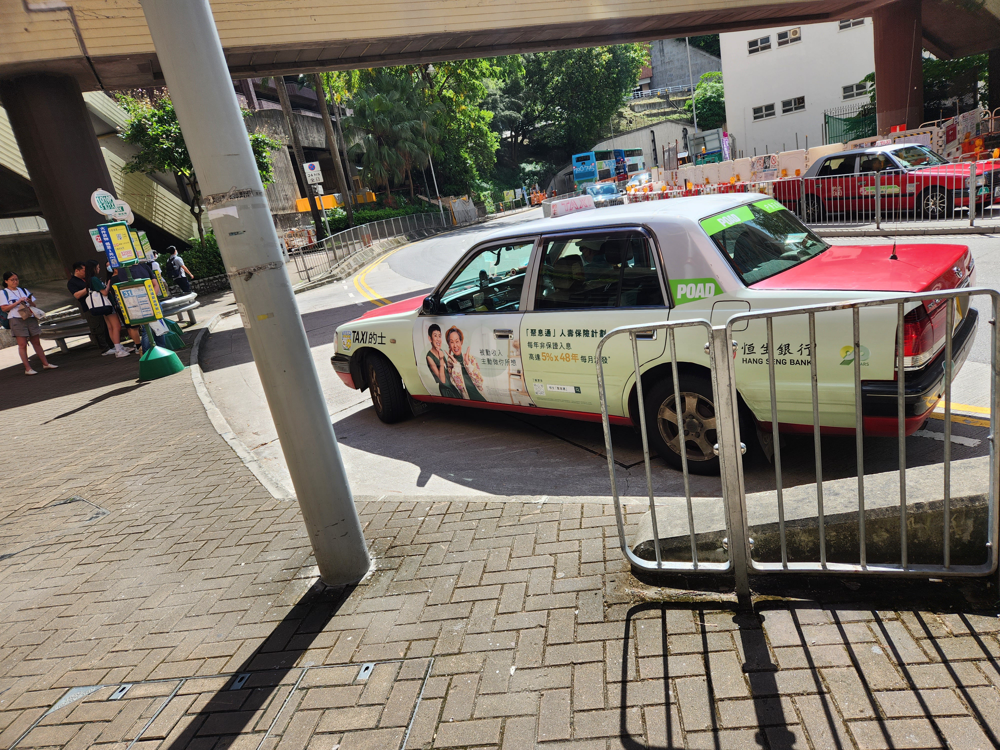

Reference: a taxi parked on the road in front of a post and a fence on the sidewalk
Generated caption: A man in a suit and tie standing in front of a building.
File name: photo1.jpg
Time taken: 2.27
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
tokenization...
setting up scorers...
computing Bleu score...
{'testlen': 13, 'reflen': 17, 'guess': [13, 12, 11, 10], 'correct': [7, 3, 2, 1]}
ratio: 0.7647058823079586
Bleu_1: 0.396
Bleu_2: 0.270
Bleu_3: 0.213
Bleu_4: 0.164
computing METEOR score...
METEOR: 0.139
computing Rouge score...
ROUGE_L: 0.326
computing CIDEr score...
CIDEr: 0.000
computing SPICE score...
SPICE: 0.105
Subjectivity:  0.0
i:  0


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.23s/it]


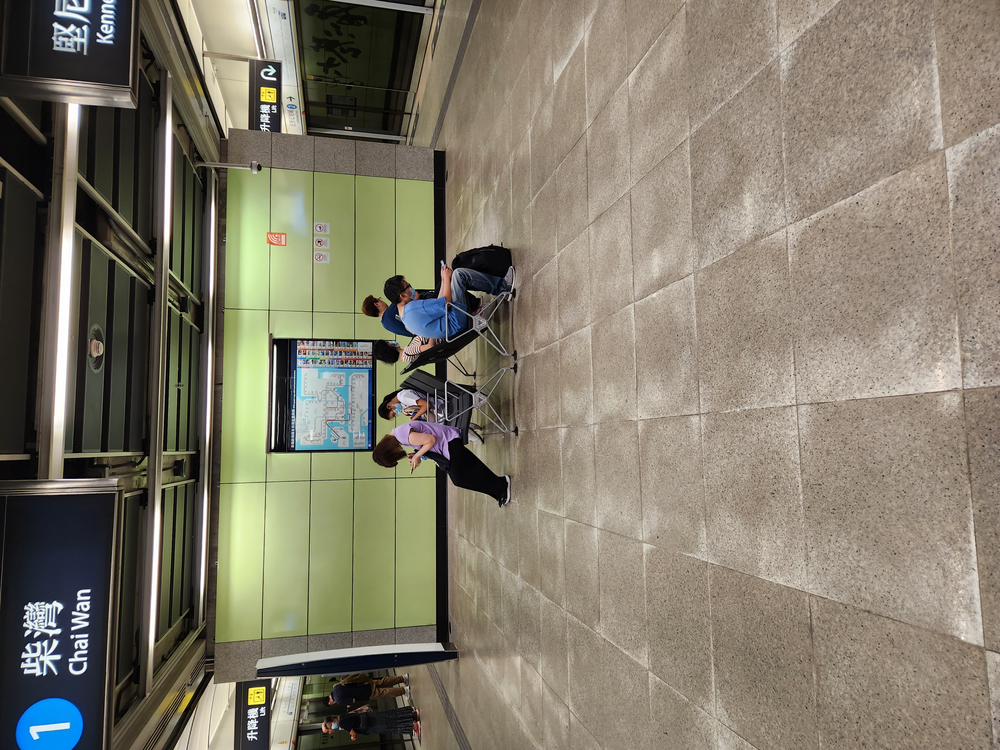

Reference: people sitting and using their phone in the subway station
Generated caption: A man in a suit and tie standing in front of a building.
File name: photo2.jpg
Time taken: 1.64
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
tokenization...
setting up scorers...
computing Bleu score...
{'testlen': 13, 'reflen': 10, 'guess': [13, 12, 11, 10], 'correct': [2, 0, 0, 0]}
ratio: 1.2999999998700003
Bleu_1: 0.154
Bleu_2: 0.000
Bleu_3: 0.000
Bleu_4: 0.000
computing METEOR score...
METEOR: 0.053
computing Rouge score...
ROUGE_L: 0.178
computing CIDEr score...
CIDEr: 0.000
computing SPICE score...
SPICE: 0.000
Subjectivity:  0.0
i:  1


  0%|                                                                                            | 0/1 [00:00<?, ?it/s]


KeyboardInterrupt: 

In [7]:
#@title Model
#@title Imports

import clip
import os
from torch import nn
import numpy as np
import torch
import torch.nn.functional as nnf
import sys
from typing import Tuple, List, Union, Optional
from transformers import GPT2Tokenizer, GPT2LMHeadModel, AdamW, get_linear_schedule_with_warmup
from tqdm import tqdm, trange
#from google.colab import files
import skimage.io as io
import PIL.Image
from IPython.display import Image
from nltk.translate.bleu_score import corpus_bleu
from nltk.translate.meteor_score import meteor_score
import nltk
from nltk.translate.bleu_score import sentence_bleu
import json
from pycocotools.coco import COCO
from pycocoevalcap.eval import COCOEvalCap
from textblob import TextBlob

annotation_file = 'annotation.json'
results_file = 'results.json'
nltk.download('wordnet')

N = type(None)
V = np.array
ARRAY = np.ndarray
ARRAYS = Union[Tuple[ARRAY, ...], List[ARRAY]]
VS = Union[Tuple[V, ...], List[V]]
VN = Union[V, N]
VNS = Union[VS, N]
T = torch.Tensor
TS = Union[Tuple[T, ...], List[T]]
TN = Optional[T]
TNS = Union[Tuple[TN, ...], List[TN]]
TSN = Optional[TS]
TA = Union[T, ARRAY]

D = torch.device
CPU = torch.device('cpu')


def get_device(device_id: int) -> D:
    if not torch.cuda.is_available():
        return CPU
    device_id = min(torch.cuda.device_count() - 1, device_id)
    return torch.device(f'cuda:{device_id}')

CUDA = get_device

current_directory = os.getcwd()
save_path = os.path.join(os.path.dirname(current_directory), "pretrained_models")
os.makedirs(save_path, exist_ok=True)
model_path = os.path.join(save_path, 'model_wieghts.pt')

class MLP(nn.Module):

    def forward(self, x: T) -> T:
        return self.model(x)

    def __init__(self, sizes: Tuple[int, ...], bias=True, act=nn.Tanh):
        super(MLP, self).__init__()
        layers = []
        for i in range(len(sizes) -1):
            layers.append(nn.Linear(sizes[i], sizes[i + 1], bias=bias))
            if i < len(sizes) - 2:
                layers.append(act())
        self.model = nn.Sequential(*layers)


class ClipCaptionModel(nn.Module):

    #@functools.lru_cache #FIXME
    def get_dummy_token(self, batch_size: int, device: D) -> T:
        return torch.zeros(batch_size, self.prefix_length, dtype=torch.int64, device=device)

    def forward(self, tokens: T, prefix: T, mask: Optional[T] = None, labels: Optional[T] = None):
        embedding_text = self.gpt.transformer.wte(tokens)
        prefix_projections = self.clip_project(prefix).view(-1, self.prefix_length, self.gpt_embedding_size)
        #print(embedding_text.size()) #torch.Size([5, 67, 768])
        #print(prefix_projections.size()) #torch.Size([5, 1, 768])
        embedding_cat = torch.cat((prefix_projections, embedding_text), dim=1)
        if labels is not None:
            dummy_token = self.get_dummy_token(tokens.shape[0], tokens.device)
            labels = torch.cat((dummy_token, tokens), dim=1)
        out = self.gpt(inputs_embeds=embedding_cat, labels=labels, attention_mask=mask)
        return out

    def __init__(self, prefix_length: int, prefix_size: int = 512):
        super(ClipCaptionModel, self).__init__()
        self.prefix_length = prefix_length
        self.gpt = GPT2LMHeadModel.from_pretrained('gpt2')
        self.gpt_embedding_size = self.gpt.transformer.wte.weight.shape[1]
        if prefix_length > 10:  # not enough memory
            self.clip_project = nn.Linear(prefix_size, self.gpt_embedding_size * prefix_length)
        else:
            self.clip_project = MLP((prefix_size, (self.gpt_embedding_size * prefix_length) // 2, self.gpt_embedding_size * prefix_length))


class ClipCaptionPrefix(ClipCaptionModel):

    def parameters(self, recurse: bool = True):
        return self.clip_project.parameters()

    def train(self, mode: bool = True):
        super(ClipCaptionPrefix, self).train(mode)
        self.gpt.eval()
        return self

def generate_beam(model, tokenizer, beam_size: int = 5, prompt=None, embed=None,
                  entry_length=67, temperature=1., stop_token: str = '.'):

    model.eval()
    stop_token_index = tokenizer.encode(stop_token)[0]
    tokens = None
    scores = None
    device = next(model.parameters()).device
    seq_lengths = torch.ones(beam_size, device=device)
    is_stopped = torch.zeros(beam_size, device=device, dtype=torch.bool)
    with torch.no_grad():
        if embed is not None:
            generated = embed
        else:
            if tokens is None:
                tokens = torch.tensor(tokenizer.encode(prompt))
                tokens = tokens.unsqueeze(0).to(device)
                generated = model.gpt.transformer.wte(tokens)
        for i in range(entry_length):
            outputs = model.gpt(inputs_embeds=generated)
            logits = outputs.logits
            logits = logits[:, -1, :] / (temperature if temperature > 0 else 1.0)
            logits = logits.softmax(-1).log()
            if scores is None:
                scores, next_tokens = logits.topk(beam_size, -1)
                generated = generated.expand(beam_size, *generated.shape[1:])
                next_tokens, scores = next_tokens.permute(1, 0), scores.squeeze(0)
                if tokens is None:
                    tokens = next_tokens
                else:
                    tokens = tokens.expand(beam_size, *tokens.shape[1:])
                    tokens = torch.cat((tokens, next_tokens), dim=1)
            else:
                logits[is_stopped] = -float(np.inf)
                logits[is_stopped, 0] = 0
                scores_sum = scores[:, None] + logits
                seq_lengths[~is_stopped] += 1
                scores_sum_average = scores_sum / seq_lengths[:, None]
                scores_sum_average, next_tokens = scores_sum_average.view(-1).topk(beam_size, -1)
                next_tokens_source = next_tokens // scores_sum.shape[1]
                seq_lengths = seq_lengths[next_tokens_source]
                next_tokens = next_tokens % scores_sum.shape[1]
                next_tokens = next_tokens.unsqueeze(1)
                tokens = tokens[next_tokens_source]
                tokens = torch.cat((tokens, next_tokens), dim=1)
                generated = generated[next_tokens_source]
                scores = scores_sum_average * seq_lengths
                is_stopped = is_stopped[next_tokens_source]
            next_token_embed = model.gpt.transformer.wte(next_tokens.squeeze()).view(generated.shape[0], 1, -1)
            generated = torch.cat((generated, next_token_embed), dim=1)
            is_stopped = is_stopped + next_tokens.eq(stop_token_index).squeeze()
            if is_stopped.all():
                break
    scores = scores / seq_lengths
    output_list = tokens.cpu().numpy()
    output_texts = [tokenizer.decode(output[:int(length)]) for output, length in zip(output_list, seq_lengths)]
    order = scores.argsort(descending=True)
    output_texts = [output_texts[i] for i in order]
    return output_texts


def generate2(
        model,
        tokenizer,
        tokens=None,
        prompt=None,
        embed=None,
        entry_count=1,
        entry_length=67,  # maximum number of words
        top_p=0.8,
        temperature=1.,
        stop_token: str = '.',
):
    model.eval()
    generated_num = 0
    generated_list = []
    stop_token_index = tokenizer.encode(stop_token)[0]
    filter_value = -float("Inf")
    device = next(model.parameters()).device

    with torch.no_grad():

        for entry_idx in trange(entry_count):
            if embed is not None:
                generated = embed
            else:
                if tokens is None:
                    tokens = torch.tensor(tokenizer.encode(prompt))
                    tokens = tokens.unsqueeze(0).to(device)

                generated = model.gpt.transformer.wte(tokens)

            for i in range(entry_length):

                outputs = model.gpt(inputs_embeds=generated)
                logits = outputs.logits
                logits = logits[:, -1, :] / (temperature if temperature > 0 else 1.0)
                sorted_logits, sorted_indices = torch.sort(logits, descending=True)
                cumulative_probs = torch.cumsum(nnf.softmax(sorted_logits, dim=-1), dim=-1)
                sorted_indices_to_remove = cumulative_probs > top_p
                sorted_indices_to_remove[..., 1:] = sorted_indices_to_remove[
                                                    ..., :-1
                                                    ].clone()
                sorted_indices_to_remove[..., 0] = 0

                indices_to_remove = sorted_indices[sorted_indices_to_remove]
                logits[:, indices_to_remove] = filter_value
                next_token = torch.argmax(logits, -1).unsqueeze(0)
                next_token_embed = model.gpt.transformer.wte(next_token)
                if tokens is None:
                    tokens = next_token
                else:
                    tokens = torch.cat((tokens, next_token), dim=1)
                generated = torch.cat((generated, next_token_embed), dim=1)
                if stop_token_index == next_token.item():
                    break

            output_list = list(tokens.squeeze().cpu().numpy())
            output_text = tokenizer.decode(output_list)
            generated_list.append(output_text)

    return generated_list[0]

is_gpu = False #@param {type:"boolean"}

device = CUDA(0) if is_gpu else "cpu"
clip_model, preprocess = clip.load("ViT-B/32", device=device, jit=False)
tokenizer = GPT2Tokenizer.from_pretrained("gpt2")

prefix_length = 10

model = ClipCaptionModel(prefix_length)

model_path = "split4_gpt-010.pt"

model.load_state_dict(torch.load(model_path, map_location=CPU), strict=False)

model = model.eval()
device = CUDA(0) if is_gpu else "cpu"
model = model.to(device)

use_beam_search = False #@param {type:"boolean"}

import csv
import glob
import time
from PIL import Image
import os
import torch
IMAGE_FOLDER = "./testing3"
import csv
reference = []
with open("testing3.csv", newline='') as f:
    csvreader = csv.reader(f)
    for row in csvreader:
        reference.append(row[1])
# Define custom sort function that sorts file names based on numeric suffixes
def numeric_sort(file_path):
    prefix, suffix = file_path.split("/")[-1].split(".")[0].split("photo")
    return int(suffix)

# Get list of image file paths
image_paths = sorted(glob.glob(IMAGE_FOLDER + "/*.jpg"), key=numeric_sort)

time_sum = 0
i = 0
bleu1 = []
bleu2 = []
bleu3 = []
bleu4 = []
meteor = []
rougel = []
cider = []
spice = []
subject = []
# Open the CSV file for writing
with open('clipcap_testing3_split4_gpt-010.csv', 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(['File Name', 'Output', 'Time Taken', 'Bleu_1', 'Bleu_2', 'Bleu_3', 'Bleu_4', 'METEOR', 'ROUGE_L', 'CIDEr', 'SPICE', 'subjectivity'])

    # Loop over each image file path
    for image_path in image_paths:
        start_time = time.time()
        # Open image using PIL
        img = Image.open(image_path)
        image = preprocess(img).unsqueeze(0).to(device)

        with torch.no_grad():
            # if type(model) is ClipCaptionE2E:
            #     prefix_embed = model.forward_image(image)
            # else:
            prefix = clip_model.encode_image(image).to(device, dtype=torch.float32)
            prefix_embed = model.clip_project(prefix).reshape(1, prefix_length, -1)
        if use_beam_search:
            generated_text_prefix = generate_beam(model, tokenizer, embed=prefix_embed)[0]
        else:
            generated_text_prefix = generate2(model, tokenizer, embed=prefix_embed)


        # Display image and output
        end_time = time.time()
        time_taken = round(end_time - start_time, 2)
        time_sum += time_taken


        display(img)
        print("Reference:", reference[i])
        print("Generated caption:", generated_text_prefix)
        # Extract file name from the path
        file_name = os.path.basename(image_path)
        print("File name:", file_name)
        print("Time taken: {}".format(time_taken))
        
        image_file = 'annotation.jpg'
        # Create a dictionary with information about the image
        image_info = {
            'id': 0,
            'file_name': image_file,
            'width': 640,
            'height': 480
        }

        # Create a list with information about the annotation (only one image, so the image_id is always 0)
        annotation_info = [
            {
                'id': 0,
                'image_id': 0,
                'caption': reference[i],
                'category_id': 0
            }
        ]

        # Create a dictionary with information about the categories
        category_info = [
            {
                'id': 0,
                'name': 'cat'
            }
        ]

        # Create a dictionary with information about the dataset
        annotation_info = {
            'info': {
                'description': 'One image dataset',
                'version': '1.0',
                'year': 2022,
                'contributor': 'Your Name'
            },
            'licenses': [],
            'images': [image_info],
            'annotations': annotation_info,
            'categories': category_info
        }


        with open(annotation_file, 'w') as f:
            json.dump(annotation_info, f)
            results_info = {"image_id": 0, "caption": generated_text_prefix}
        with open(results_file, 'w') as f:
            json.dump([results_info], f)

        # Create a COCO object for the annotations and a COCO object for the predicted captions
        coco = COCO(annotation_file)
        coco_result = coco.loadRes(results_file)

        # Create a COCOEvalCap object using the annotations and predicted captions
        coco_eval = COCOEvalCap(coco, coco_result)

        # Set the image IDs to evaluate (this can be a subset, or all images)
        coco_eval.params['image_id'] = coco_result.getImgIds()

        # Evaluate the results using the COCO evaluation metrics (this can take a few minutes)
        coco_eval.evaluate()
        subjectivity_score = TextBlob(generated_text_prefix).subjectivity
        subject.append(subjectivity_score)
        print("Subjectivity: ", subjectivity_score)


        # Write the image details to the CSV file
        print("i: ", i)
        writer.writerow([file_name, generated_text_prefix, time_taken, coco_eval.eval['Bleu_1'], coco_eval.eval['Bleu_2'], coco_eval.eval['Bleu_3'], coco_eval.eval['Bleu_4'], coco_eval.eval['METEOR'], coco_eval.eval['ROUGE_L'], coco_eval.eval['CIDEr'], coco_eval.eval['SPICE'], subjectivity_score])
        i += 1
        bleu1.append(coco_eval.eval['Bleu_1'])
        bleu2.append(coco_eval.eval['Bleu_2'])
        bleu3.append(coco_eval.eval['Bleu_3'])
        bleu4.append(coco_eval.eval['Bleu_4'])
        meteor.append(coco_eval.eval['METEOR'])
        rougel.append(coco_eval.eval['ROUGE_L'])
        cider.append(coco_eval.eval['CIDEr'])
        spice.append(coco_eval.eval['SPICE'])
        

        

print(f"Average time taken:{time_sum/50:.6f}")
print(f"Average Bleu1 score:{sum(bleu1)/50:.6f}")
print(f"Average Bleu2 score:{sum(bleu2)/50:.6f}")
print(f"Average Bleu3 score:{sum(bleu3)/50:.6f}")
print(f"Average Bleu4 score:{sum(bleu4)/50:.6f}")
print(f"Average Meteor score:{sum(meteor)/50:.6f}")
print(f"Average ROUGEL score:{sum(rougel)/50:.6f}")
print(f"Average CIDEr score:{sum(cider)/50:.6f}")
print(f"Average SPICE score:{sum(spice)/50:.6f}")
print(f"Average subjectivity score:{sum(subject)/50:.6f}")


In [1]:
#@title Caption prediction

def generate_beam(model, tokenizer, beam_size: int = 5, prompt=None, embed=None,
                  entry_length=67, temperature=1., stop_token: str = '.'):

    model.eval()
    stop_token_index = tokenizer.encode(stop_token)[0]
    tokens = None
    scores = None
    device = next(model.parameters()).device
    seq_lengths = torch.ones(beam_size, device=device)
    is_stopped = torch.zeros(beam_size, device=device, dtype=torch.bool)
    with torch.no_grad():
        if embed is not None:
            generated = embed
        else:
            if tokens is None:
                tokens = torch.tensor(tokenizer.encode(prompt))
                tokens = tokens.unsqueeze(0).to(device)
                generated = model.gpt.transformer.wte(tokens)
        for i in range(entry_length):
            outputs = model.gpt(inputs_embeds=generated)
            logits = outputs.logits
            logits = logits[:, -1, :] / (temperature if temperature > 0 else 1.0)
            logits = logits.softmax(-1).log()
            if scores is None:
                scores, next_tokens = logits.topk(beam_size, -1)
                generated = generated.expand(beam_size, *generated.shape[1:])
                next_tokens, scores = next_tokens.permute(1, 0), scores.squeeze(0)
                if tokens is None:
                    tokens = next_tokens
                else:
                    tokens = tokens.expand(beam_size, *tokens.shape[1:])
                    tokens = torch.cat((tokens, next_tokens), dim=1)
            else:
                logits[is_stopped] = -float(np.inf)
                logits[is_stopped, 0] = 0
                scores_sum = scores[:, None] + logits
                seq_lengths[~is_stopped] += 1
                scores_sum_average = scores_sum / seq_lengths[:, None]
                scores_sum_average, next_tokens = scores_sum_average.view(-1).topk(beam_size, -1)
                next_tokens_source = next_tokens // scores_sum.shape[1]
                seq_lengths = seq_lengths[next_tokens_source]
                next_tokens = next_tokens % scores_sum.shape[1]
                next_tokens = next_tokens.unsqueeze(1)
                tokens = tokens[next_tokens_source]
                tokens = torch.cat((tokens, next_tokens), dim=1)
                generated = generated[next_tokens_source]
                scores = scores_sum_average * seq_lengths
                is_stopped = is_stopped[next_tokens_source]
            next_token_embed = model.gpt.transformer.wte(next_tokens.squeeze()).view(generated.shape[0], 1, -1)
            generated = torch.cat((generated, next_token_embed), dim=1)
            is_stopped = is_stopped + next_tokens.eq(stop_token_index).squeeze()
            if is_stopped.all():
                break
    scores = scores / seq_lengths
    output_list = tokens.cpu().numpy()
    output_texts = [tokenizer.decode(output[:int(length)]) for output, length in zip(output_list, seq_lengths)]
    order = scores.argsort(descending=True)
    output_texts = [output_texts[i] for i in order]
    return output_texts


def generate2(
        model,
        tokenizer,
        tokens=None,
        prompt=None,
        embed=None,
        entry_count=1,
        entry_length=67,  # maximum number of words
        top_p=0.8,
        temperature=1.,
        stop_token: str = '.',
):
    model.eval()
    generated_num = 0
    generated_list = []
    stop_token_index = tokenizer.encode(stop_token)[0]
    filter_value = -float("Inf")
    device = next(model.parameters()).device

    with torch.no_grad():

        for entry_idx in trange(entry_count):
            if embed is not None:
                generated = embed
            else:
                if tokens is None:
                    tokens = torch.tensor(tokenizer.encode(prompt))
                    tokens = tokens.unsqueeze(0).to(device)

                generated = model.gpt.transformer.wte(tokens)

            for i in range(entry_length):

                outputs = model.gpt(inputs_embeds=generated)
                logits = outputs.logits
                logits = logits[:, -1, :] / (temperature if temperature > 0 else 1.0)
                sorted_logits, sorted_indices = torch.sort(logits, descending=True)
                cumulative_probs = torch.cumsum(nnf.softmax(sorted_logits, dim=-1), dim=-1)
                sorted_indices_to_remove = cumulative_probs > top_p
                sorted_indices_to_remove[..., 1:] = sorted_indices_to_remove[
                                                    ..., :-1
                                                    ].clone()
                sorted_indices_to_remove[..., 0] = 0

                indices_to_remove = sorted_indices[sorted_indices_to_remove]
                logits[:, indices_to_remove] = filter_value
                next_token = torch.argmax(logits, -1).unsqueeze(0)
                next_token_embed = model.gpt.transformer.wte(next_token)
                if tokens is None:
                    tokens = next_token
                else:
                    tokens = torch.cat((tokens, next_token), dim=1)
                generated = torch.cat((generated, next_token_embed), dim=1)
                if stop_token_index == next_token.item():
                    break

            output_list = list(tokens.squeeze().cpu().numpy())
            output_text = tokenizer.decode(output_list)
            generated_list.append(output_text)

    return generated_list[0]

In [2]:
#@title GPU/CPU


is_gpu = False #@param {type:"boolean"}


In [3]:
#@title CLIP model + GPT2 tokenizer
import clip
device = CUDA(0) if is_gpu else "cpu"
clip_model, preprocess = clip.load("ViT-B/32", device=device, jit=False)
tokenizer = GPT2Tokenizer.from_pretrained("gpt2")

NameError: name 'GPT2Tokenizer' is not defined

In [ ]:
%cd /content/drive/MyDrive/CLIP_prefix_caption

In [ ]:
#@title Load model weights
import clip

prefix_length = 10

model = ClipCaptionModel(prefix_length)

model_path = ".\coco_wieghts.pt"

model.load_state_dict(torch.load(model_path, map_location=CPU), strict=False)

model = model.eval()
device = CUDA(0) if is_gpu else "cpu"
model = model.to(device)


In [ ]:
print(model_path)

In [ ]:
#@title Upload Image


uploaded = files.upload()

if not uploaded:
  UPLOADED_FILE = ''
elif len(uploaded) == 1:
  UPLOADED_FILE = list(uploaded.keys())[0]
else:
  raise AssertionError('Please upload one image at a time')

print(UPLOADED_FILE)

In [ ]:
import requests
import shutil

def get_image(url: str, out_path: str, timeout=10):
    try:
        r = requests.get(url, stream=True, timeout=timeout)
        if r.status_code == 200:
            with open(out_path, 'wb') as f:
                r.raw.decode_content = True
                shutil.copyfileobj(r.raw, f)
            return True
        return False
    except BaseException:
        return False

get_image("https://i.postimg.cc/RFLkvgrn/2022-06-20-11-09-55.png", "/content/image.jpg")

In [ ]:
#@title Or download random samples form COCO test set (Karpathy et al. split)

IMAGE_NAME = '354533'  # @param ['562207', '579664', '060623', '165547', '334321', '483108', '386164', '354533']

name_ = "COCO_val2014_000000" + IMAGE_NAME + ".jpg"
images_path = os.path.join(os.path.dirname(current_directory), "images")
os.makedirs(images_path, exist_ok=True)
UPLOADED_FILE = os.path.join(images_path, name_)

if not os.path.isfile(UPLOADED_FILE):
  download_path = os.path.join(images_path, "images.zip")
  downloader.download_file("1BwJeBME-dpwcCT8IXYeWz7uaPkbexjNB", download_path)

  !unzip {download_path} -d {images_path}



Conceptual captions examples:
https://drive.google.com/file/d/1mzH3b0LQrGEWjEva4hI6HE_fIYRIgtBT/view?usp=sharing

In [ ]:
#@title Inference
use_beam_search = False #@param {type:"boolean"}

image = io.imread('/content/image.jpg')
pil_image = PIL.Image.fromarray(image)
#pil_img = Image(filename=UPLOADED_FILE)
display(pil_image)

image = preprocess(pil_image).unsqueeze(0).to(device)
with torch.no_grad():
    # if type(model) is ClipCaptionE2E:
    #     prefix_embed = model.forward_image(image)
    # else:
    prefix = clip_model.encode_image(image).to(device, dtype=torch.float32)
    prefix_embed = model.clip_project(prefix).reshape(1, prefix_length, -1)
if use_beam_search:
    generated_text_prefix = generate_beam(model, tokenizer, embed=prefix_embed)[0]
else:
    generated_text_prefix = generate2(model, tokenizer, embed=prefix_embed)


print('\n')
print(generated_text_prefix)

In [ ]:
%cd /content/drive/MyDrive/test results

In [ ]:
#@title Inference
use_beam_search = False #@param {type:"boolean"}

import csv
import glob
import time
from PIL import Image
import os
import torch
IMAGE_FOLDER = "/content/drive/MyDrive/testing2"
# Define custom sort function that sorts file names based on numeric suffixes
def numeric_sort(file_path):
    prefix, suffix = file_path.split("/")[-1].split(".")[0].split("photo")
    return int(suffix)

# Get list of image file paths
image_paths = sorted(glob.glob(IMAGE_FOLDER + "/*.jpg") + glob.glob(IMAGE_FOLDER + "/*.JPG"), key=numeric_sort)

time_sum = 0

# Open the CSV file for writing
with open('ClipCap-concept_testing2_mlp-gpt2finetune_customtrain1000.csv', 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(['File Name', 'Output', 'Time Taken'])

    # Loop over each image file path
    for image_path in image_paths:
        start_time = time.time()
        # Open image using PIL
        img = Image.open(image_path)
        image = preprocess(img).unsqueeze(0).to(device)

        with torch.no_grad():
            # if type(model) is ClipCaptionE2E:
            #     prefix_embed = model.forward_image(image)
            # else:
            prefix = clip_model.encode_image(image).to(device, dtype=torch.float32)
            prefix_embed = model.clip_project(prefix).reshape(1, prefix_length, -1)
        if use_beam_search:
            generated_text_prefix = generate_beam(model, tokenizer, embed=prefix_embed)[0]
        else:
            generated_text_prefix = generate2(model, tokenizer, embed=prefix_embed)


        # Display image and output
        end_time = time.time()
        time_taken = round(end_time - start_time, 2)
        time_sum += time_taken


        display(img)
        print("Generated caption:", generated_text_prefix)
        # Extract file name from the path
        file_name = os.path.basename(image_path)
        print("File name:", file_name)
        print("Time taken: {}".format(time_taken))

        # Write the image details to the CSV file
        writer.writerow([file_name, generated_text_prefix, time_taken])

print("Average time taken:", time_sum/50)

In [ ]:
%cd /content/drive/MyDrive

In [ ]:
%cd /content/drive/MyDrive
!git clone https://github.com/rmokady/CLIP_prefix_caption